In [ ]:
import os
import pandas as pd
import pandas
# ! pip install boto3
# import boto3
from os import listdir
from os.path import isfile, join
import plotly.express as px
import seaborn as sns
from os import listdir
from os.path import isfile, join
from math import sin, cos, sqrt, atan2


In [ ]:
# !pip install geocoder
# !pip install reverse_geocoder
# !pip install shapely
# ! pip install geopandas

import geopandas as gpd
import pandas as pd
import numpy as np
from shapely.geometry import Point

import geocoder
import time

import reverse_geocoder as rg


Requirement already satisfied: geocoder in /databricks/python3/lib/python3.8/site-packages (1.38.1)
Requirement already satisfied: six in /databricks/python3/lib/python3.8/site-packages (from geocoder) (1.15.0)
Requirement already satisfied: ratelim in /databricks/python3/lib/python3.8/site-packages (from geocoder) (0.1.6)
Requirement already satisfied: click in /databricks/python3/lib/python3.8/site-packages (from geocoder) (8.1.3)
Requirement already satisfied: requests in /databricks/python3/lib/python3.8/site-packages (from geocoder) (2.25.1)
Requirement already satisfied: future in /databricks/python3/lib/python3.8/site-packages (from geocoder) (0.18.2)
Requirement already satisfied: decorator in /databricks/python3/lib/python3.8/site-packages (from ratelim->geocoder) (5.0.6)
Requirement already satisfied: certifi>=2017.4.17 in /databricks/python3/lib/python3.8/site-packages (from requests->geocoder) (2020.12.5)
Requirement already satisfied: chardet<5,>=3.0.2 in /databricks/python3/lib/python3.8/site-packages (from requests->geocoder) (4.0.0)
Requirement already satisfied: urllib3<1.27,>=1.21.1 in /databricks/python3/lib/python3.8/site-packages (from requests->geocoder) (1.25.11)
Requirement already satisfied: idna<3,>=2.5 in /databricks/python3/lib/python3.8/site-packages (from requests->geocoder) (2.10)
 WARNING: You are using pip version 21.0.1; however, version 22.1.2 is available.
You should consider upgrading via the '/databricks/python3/bin/python -m pip install --upgrade pip' command. 
Requirement already satisfied: reverse_geocoder in /databricks/python3/lib/python3.8/site-packages (1.5.1)
Requirement already satisfied: scipy>=0.17.1 in /databricks/python3/lib/python3.8/site-packages (from reverse_geocoder) (1.6.2)
Requirement already satisfied: numpy>=1.11.0 in /databricks/python3/lib/python3.8/site-packages (from reverse_geocoder) (1.20.1)
 WARNING: You are using pip version 21.0.1; however, version 22.1.2 is available.
You should consider upgrading via the '/databricks/python3/bin/python -m pip install --upgrade pip' command. 
Requirement already satisfied: shapely in /databricks/python3/lib/python3.8/site-packages (1.8.2)
 WARNING: You are using pip version 21.0.1; however, version 22.1.2 is available.
You should consider upgrading via the '/databricks/python3/bin/python -m pip install --upgrade pip' command. 
Requirement already satisfied: geopandas in /databricks/python3/lib/python3.8/site-packages (0.11.0)
Requirement already satisfied: pyproj>=2.6.1.post1 in /databricks/python3/lib/python3.8/site-packages (from geopandas) (3.3.1)
Requirement already satisfied: shapely<2,>=1.7 in /databricks/python3/lib/python3.8/site-packages (from geopandas) (1.8.2)
Requirement already satisfied: pandas>=1.0.0 in /databricks/python3/lib/python3.8/site-packages (from geopandas) (1.2.4)
Requirement already satisfied: packaging in /databricks/python3/lib/python3.8/site-packages (from geopandas) (20.9)
Requirement already satisfied: fiona>=1.8 in /databricks/python3/lib/python3.8/site-packages (from geopandas) (1.8.21)
Requirement already satisfied: six>=1.7 in /databricks/python3/lib/python3.8/site-packages (from fiona>=1.8->geopandas) (1.15.0)
Requirement already satisfied: setuptools in /usr/local/lib/python3.8/dist-packages (from fiona>=1.8->geopandas) (52.0.0)
Requirement already satisfied: click>=4.0 in /databricks/python3/lib/python3.8/site-packages (from fiona>=1.8->geopandas) (8.1.3)
Requirement already satisfied: certifi in /databricks/python3/lib/python3.8/site-packages (from fiona>=1.8->geopandas) (2020.12.5)
Requirement already satisfied: munch in /databricks/python3/lib/python3.8/site-packages (from fiona>=1.8->geopandas) (2.5.0)
Requirement already satisfied: cligj>=0.5 in /databricks/python3/lib/python3.8/site-packages (from fiona>=1.8->geopandas) (0.7.2)
Requirement already satisfied: click-plugins>=1.0 in /databricks/python3/lib/python3.8/site-packages (from fiona>=1.8->geo

### I- Creation de la table

In [ ]:
storage_account="sa0metamobia0datawork"
key="ZkCCWmwrhRWMP/+vfLgAMyeqW5ivU1fPKarOIC+HWWEGD4nWAl2+mgrb9U3XL4C2uWGHAz1Vgbtu+ASt6mKTLw=="

try:
    container="raw"
#     dbutils.fs.unmount(f"/mnt/{container}")#
    dbutils.fs.mount(
      source = f"wasbs://{container}@{storage_account}.blob.core.windows.net",
      mount_point = f"/mnt/{container}",
      extra_configs = {f"fs.azure.account.key.{storage_account}.blob.core.windows.net":f"{key}"})
except:
    print("oh maybe already exist!")

oh maybe already exist!

In [1]:
# path= '/mnt/raw/Irys_data/'

# # # dbutils.fs.ls(path)
# df= spark.read.parquet(dbutils.fs.ls(dbutils.fs.ls(path)[0].path)[1].path)

# for path_tmp in dbutils.fs.ls(path):
#     for path_tmp2 in dbutils.fs.ls(path_tmp.path):
#         if (path_tmp2.name != '_SUCCESS'):
#             print(path_tmp2)
#             df_tmp = spark.read.parquet(path_tmp2.path)
#             df=df.unionByName(df_tmp ,allowMissingColumns=True)
        
# df

In [ ]:
df=(spark.read.parquet('/mnt/raw/Irys_data/*/*.snappy.parquet'))
display(df)
df.count()

deviceId,deviceType,eventTimeMilli,eventDate,location,countryCode,horizontalAccuracy,altitude,verticalAccuracy,bearing,speed,ipAddressV4,ipAddressV6,gdprConsentFlag,sourceBatchDate,devicePartition
99603c5b-8009-4b5c-9d92-917a60a843b6,List(AAID),1650720324000,2022-04-23,"List(30.37272, -9.57337)",MAR,30.0,null,null,null,null,196.64.38.115,null,null,2022-04-23,38
99603c5b-8009-4b5c-9d92-917a60a843b6,List(AAID),1650719832000,2022-04-23,"List(30.37272, -9.57337)",MAR,30.0,null,null,null,null,196.64.38.115,null,null,2022-04-23,38
99603c5b-8009-4b5c-9d92-917a60a843b6,List(AAID),1650714998000,2022-04-23,"List(30.37272, -9.57337)",MAR,30.0,null,null,null,null,105.157.218.138,null,null,2022-04-23,38
996046e5-e25a-4e5a-910e-d6da8783a5bc,List(AAID),1650751203000,2022-04-23,"List(33.56893, -7.60675)",MAR,20.0,null,null,null,null,105.158.60.115,null,null,2022-04-23,38
996046e5-e25a-4e5a-910e-d6da8783a5bc,List(AAID),1650740413000,2022-04-23,"List(33.56893, -7.60675)",MAR,20.0,null,null,null,null,105.158.60.115,null,null,2022-04-23,38
996046e5-e25a-4e5a-910e-d6da8783a5bc,List(AAID),1650750389000,2022-04-23,"List(33.56893, -7.60675)",MAR,20.0,null,null,null,null,105.158.60.115,null,null,2022-04-23,38
996046e5-e25a-4e5a-910e-d6da8783a5bc,List(AAID),1650751264000,2022-04-23,"List(33.56893, -7.60675)",MAR,20.0,null,null,null,null,105.158.60.115,null,null,2022-04-23,38
996046e5-e25a-4e5a-910e-d6da8783a5bc,List(AAID),1650753504000,2022-04-23,"List(33.56893, -7.60675)",MAR,20.0,null,null,null,null,105.158.60.115,null,null,2022-04-23,38
996046e5-e25a-4e5a-910e-d6da8783a5bc,List(AAID),1650738001000,2022-04-23,"List(33.56893, -7.60675)",MAR,20.0,null,null,null,null,41.143.14.29,null,null,2022-04-23,38
996046e5-e25a-4e5a-910e-d6da8783a5bc,List(AAID),1650754011000,2022-04-23,"List(33.56893, -7.60675)",MAR,20.0,null,null,null,null,105.158.60.115,null,null,2022-04-23,38


Out[2]: 91097641

In [ ]:
# pyspark  --conf "spark.driver.maxResultSize=5g"


File "<command-1865973000175382>" , line 1 
 pyspark --conf "spark.driver.maxResultSize=5g" 
 ^
 SyntaxError : invalid syntax

In [ ]:
df=df.filter((df.location.latitude <34.038407)& (df.location.latitude >33.915500) & (df.location.longitude >-6.914729) & (df.location.longitude <-6.789333))
df=df.select(['deviceId','eventTimeMilli','location.latitude', 'location.longitude'])
display(df)


deviceId,eventTimeMilli,latitude,longitude
9991d70c-a4c0-4b1c-97b1-3e24450404ed,1650704353000,33.97714,-6.82065
99a80f48-0eac-46bf-9d5f-261fe6e34623,1650685059000,33.97458,-6.88802
99a80f48-0eac-46bf-9d5f-261fe6e34623,1650751265000,33.97455,-6.88799
99a80f48-0eac-46bf-9d5f-261fe6e34623,1650751893000,33.97458,-6.88797
99a80f48-0eac-46bf-9d5f-261fe6e34623,1650679697000,33.97458,-6.88802
99a80f48-0eac-46bf-9d5f-261fe6e34623,1650739659000,33.97458,-6.88802
99a80f48-0eac-46bf-9d5f-261fe6e34623,1650738789000,33.97458,-6.88797
99a80f48-0eac-46bf-9d5f-261fe6e34623,1650723863000,33.97458,-6.88802
99a80f48-0eac-46bf-9d5f-261fe6e34623,1650682660000,33.97458,-6.88802
99a80f48-0eac-46bf-9d5f-261fe6e34623,1650740263000,33.97458,-6.88802


In [ ]:
import pyspark.pandas as ps
df=df.toPandas()
df['datetime']=pd.to_datetime(df['eventTimeMilli'], unit='ms')
df.drop(columns=['eventTimeMilli'], inplace=True)

df['day'] = df.datetime.dt.day
df['hour'] = df.datetime.dt.hour

df

Out[5]:

,deviceId,latitude,longitude,datetime,day,hour
0,9991d70c-a4c0-4b1c-97b1-3e24450404ed,33.97714,-6.82065,2022-04-23 08:59:13,23,8
1,99a80f48-0eac-46bf-9d5f-261fe6e34623,33.97458,-6.88802,2022-04-23 03:37:39,23,3
2,99a80f48-0eac-46bf-9d5f-261fe6e34623,33.97455,-6.88799,2022-04-23 22:01:05,23,22
3,99a80f48-0eac-46bf-9d5f-261fe6e34623,33.97458,-6.88797,2022-04-23 22:11:33,23,22
4,99a80f48-0eac-46bf-9d5f-261fe6e34623,33.97458,-6.88802,2022-04-23 02:08:17,23,2
...,...,...,...,...,...,...
4121171,dbff291b-1d11-4594-bed2-64f2607278be,33.92172,-6.88927,2022-04-22 23:47:44,22,23
4121172,f0f8968f-ace1-4728-9f4d-3baf65bbaa5e,33.97999,-6.88480,2022-04-26 18:47:54,26,18
4121173,cffff7ac-1a91-4788-9e1e-ff4152d782a0,33.92024,-6.90982,2022-04-16 16:22:49,16,16
4121174,53f85417-7b63-4501-96ab-6c46ef2aaa7c,33.96376,-6.86024,2022-04-27 22:11:30,27,22


In [ ]:
# la fonction distance permet de calculer la distance entre le point donné en paramtere et le centre de la cote de rabat
from geopy.distance import geodesic
def distance(lat2,lon2):
    lat1  = 34.002724
    lon1  = -6.872255
    return geodesic((lat1,lon1), (lat2,lon2)).kilometers


# inside_circle retourne 1 si le point est a l'interieur du circle, 0 sinon
def inside_circle(lat2, lon2):
    rayon_rabat=distance(34.034069,-6.836461)
    ma_distance=distance(float(lat2), float(lon2))
    if ma_distance<= rayon_rabat:
        return True
    else:
        return False

In [ ]:
# import plotly.express as px 

pandas_df=df

fig = px.scatter_mapbox(pandas_df.loc[:500000,:], lat="latitude", lon="longitude", 
                  size_max=15, zoom=10,
                  mapbox_style="carto-positron")
fig.show()

In [ ]:
df_just_rabat=pandas_df.loc[((pandas_df['latitude']<34.02829) 
                    |(pandas_df['longitude']<-6.832628))&((pandas_df['latitude']>33.94395) 
                     |(pandas_df['longitude']>-6.878487))]

fig = px.scatter_mapbox(df_just_rabat.loc[:500000,:], lat="latitude", lon="longitude",  size_max=15, zoom=10, mapbox_style="carto-positron")
fig.show()

In [ ]:
# df=spark.createDataFrame(pandas_df)
# df.write.option("header",true).csv('/mnt/working/citydata/'+'/macro_table_citydata.csv')

spark_df_just_rabat=spark.createDataFrame(df_just_rabat)
spark_df_just_rabat.write.mode('overwrite').option("header", "true").csv('/mnt/working/Irys_data/'+'/macro_table_Irys_data_rabat.csv')

In [ ]:
df_just_rabat= spark.read.csv('/mnt/working/Irys_data/'+'/macro_table_Irys_data_rabat.csv', header=True)
df_just_rabat=df_just_rabat.toPandas()
df_just_rabat['hour']=df_just_rabat['hour'].astype(int)

df_just_rabat


Out[42]:

,deviceId,latitude,longitude,datetime,day,hour
0,9991d70c-a4c0-4b1c-97b1-3e24450404ed,33.97714,-6.82065,2022-04-23T08:59:13.000Z,23,8
1,99a80f48-0eac-46bf-9d5f-261fe6e34623,33.97458,-6.88802,2022-04-23T03:37:39.000Z,23,3
2,99a80f48-0eac-46bf-9d5f-261fe6e34623,33.97455,-6.88799,2022-04-23T22:01:05.000Z,23,22
3,99a80f48-0eac-46bf-9d5f-261fe6e34623,33.97458,-6.88797,2022-04-23T22:11:33.000Z,23,22
4,99a80f48-0eac-46bf-9d5f-261fe6e34623,33.97458,-6.88802,2022-04-23T02:08:17.000Z,23,2
...,...,...,...,...,...,...
3000064,3743b17f-beb3-4a87-854f-ab79df39f19e,33.98528,-6.80674,2022-04-29T22:58:35.000Z,29,22
3000065,43fe1c35-067e-4fbe-ae2c-51a956cffeb3,34.00143,-6.81256,2022-04-27T03:55:41.000Z,27,3
3000066,98fa7980-378b-4cf9-be06-157be88784ec,33.993,-6.81024,2022-04-15T01:02:05.000Z,15,1
3000067,f0f8968f-ace1-4728-9f4d-3baf65bbaa5e,33.97999,-6.8848,2022-04-26T18:47:54.000Z,26,18


### Creation de KPI

In [ ]:
df_just_rabat.shape

Out[12]: (3000069, 6)

Out[34]:

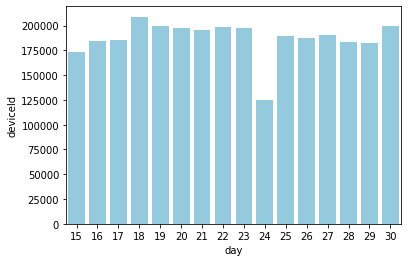

count 16.000000
mean 187504.312500
std 18776.405282
min 125202.000000
25% 184645.500000
50% 190080.000000
75% 197840.500000
max 208983.000000
Name: deviceId, dtype: float64

In [ ]:
distribution_day=df_just_rabat.groupby('day')['deviceId'].count()

sns.barplot(x="day", y="deviceId", data=distribution_day.reset_index(),color ='skyblue')
distribution_day.describe()


In [ ]:
len(df_just_rabat['deviceId'].unique())
    

Out[16]: 31229

In [ ]:
grp_by_device=df_just_rabat.groupby('deviceId').latitude.count().sort_values(ascending=False).reset_index().rename(columns={'latitude':'counts_deviceId'})
grp_by_device.describe()

Out[17]:

,counts_deviceId
count,31229.000000
mean,96.066765
std,970.088357
min,1.000000
25%,1.000000
50%,2.000000
75%,8.000000
max,28215.000000


Out[35]:

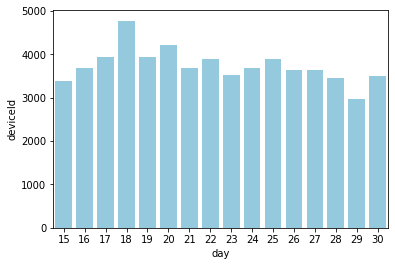

count 16.000000
mean 3740.312500
std 397.948023
min 2959.000000
25% 3520.000000
50% 3687.000000
75% 3913.250000
max 4776.000000
Name: deviceId, dtype: float64

In [ ]:
distribution_day_device_id=df_just_rabat.groupby(['day','deviceId'])['latitude'].count()
distribution_day_device_id=distribution_day_device_id.reset_index()
distribution_day_device_id=distribution_day_device_id.groupby('day')['deviceId'].count()
sns.barplot(x="day", y="deviceId", data=distribution_day_device_id.reset_index(),color ='skyblue')
distribution_day_device_id.describe()

Out[51]:

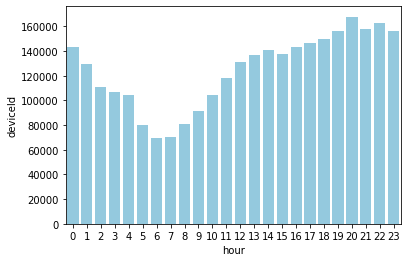

count 24.000000
mean 125002.875000
std 30332.975422
min 69950.000000
25% 104434.750000
50% 134385.000000
75% 147371.500000
max 167893.000000
Name: deviceId, dtype: float64

In [ ]:
df_just_rabat['hour']=df_just_rabat['hour'].astype(int)

distribution_hour=df_just_rabat.groupby('hour')['deviceId'].count()

sns.barplot(x="hour", y="deviceId", data=distribution_hour.reset_index().sort_values('hour'),color ='skyblue')
distribution_hour.describe()

Out[52]:

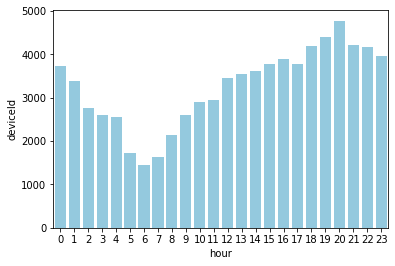

count 24.000000
mean 3257.666667
std 921.450589
min 1454.000000
25% 2599.250000
50% 3496.000000
75% 3906.000000
max 4777.000000
Name: deviceId, dtype: float64

In [ ]:
distribution_hour_device_id=df_just_rabat.groupby(['hour','deviceId'])['latitude'].count()
distribution_hour_device_id=distribution_hour_device_id.reset_index()
distribution_hour_device_id=distribution_hour_device_id.groupby('hour')['deviceId'].count()
sns.barplot(x="hour", y="deviceId", data=distribution_hour_device_id.reset_index().sort_values(by=['hour']),color ='skyblue')
distribution_hour_device_id.describe()


In [ ]:
df_just_rabat_city= spark.read.csv('/mnt/working/citydata/'+'/macro_table_citydata_rabat.csv', header=True)
df_just_rabat_city=df_just_rabat_city.toPandas()

df_just_rabat_city.rename(columns={'device_id':'deviceId'}, inplace=True)

left_joint=pd.merge(df_just_rabat['deviceId'],df_just_rabat_city['deviceId'],on='deviceId',how='outer')

left_joint

Out[30]:

,deviceId
0,9991d70c-a4c0-4b1c-97b1-3e24450404ed
1,9991d70c-a4c0-4b1c-97b1-3e24450404ed
2,9991d70c-a4c0-4b1c-97b1-3e24450404ed
3,9991d70c-a4c0-4b1c-97b1-3e24450404ed
4,9991d70c-a4c0-4b1c-97b1-3e24450404ed
...,...
5022051,NXJpbnFrNTdpdXJlcDpiMnRrdWd2cXJmdTkw
5022052,Mmg3bXQ5ZTJlMGswcTo5dHAxY2tkZ29maGI3
5022053,Nmhwc2lkZmltbDUyZTo0dXZocDIyYWdpYXNm
5022054,ZG1zZmc1Z3NucnM4bjo3cGY0bnZjcjFzMjJ0


In [ ]:
df_just_rabat

Out[5]:

,device_id,latitude,longitude,datetime,hour,day,date,inside_circle
0,NGcwcDlqYmpubmlncTo2MjRqdHM1bmdyZ3Fz,33.967102,-6.848767,2021-06-24T09:48:10.000Z,9,24,2021-06-24,true
1,MzhlN2pxdXR2dXMzbDo5ZmszZHQ3ZnI4bWRv,33.994609,-6.868181,2021-06-24T09:23:58.000Z,9,24,2021-06-24,true
2,MzhlN2pxdXR2dXMzbDo5ZmszZHQ3ZnI4bWRv,33.994609,-6.868181,2021-06-24T09:24:25.000Z,9,24,2021-06-24,true
3,MzhlN2pxdXR2dXMzbDo5ZmszZHQ3ZnI4bWRv,33.994609,-6.868181,2021-06-24T09:24:40.000Z,9,24,2021-06-24,true
4,MzhlN2pxdXR2dXMzbDo5ZmszZHQ3ZnI4bWRv,33.994609,-6.868181,2021-06-24T09:23:58.000Z,9,24,2021-06-24,true
...,...,...,...,...,...,...,...,...
2021982,M3Nwc2c4NTkzcjRobjo1NWE3djJ0bXVzbGp1,33.980554,-6.812003,2021-06-09T12:58:57.000Z,12,9,2021-06-09,false
2021983,M3Nwc2c4NTkzcjRobjo1NWE3djJ0bXVzbGp1,33.980554,-6.812003,2021-06-09T11:16:09.000Z,11,9,2021-06-09,false
2021984,MjhpOTloa25oOXBzNjpmNWlmMmo3ZXBuYm1i,33.981664,-6.887262,2021-06-09T09:32:15.000Z,9,9,2021-06-09,true
2021985,MWpvZjB2aHQ2aTllbzoxZ2c4a2RuMGxkMTE=,33.995022,-6.828325,2021-06-09T06:43:26.000Z,6,9,2021-06-09,true


In [ ]:
df_sorted=df_just_rabat.loc[df_just_rabat.deviceId.isin(list_deviceId)].sort_values(by=['deviceId', 'datetime'])
import pandas as pd
import numpy as np
df_sorted['datetime']= pd.to_datetime(df_sorted['datetime'])

### shift to extract period from two records
df_sorted['deviceId2']=df_sorted.deviceId.shift(periods=-1)  
df_sorted['datetime2']=df_sorted.datetime.shift(periods=-1)  

### permet de faire la difference juste entre les meme device_id
df_sorted=df_sorted.loc[df_sorted['deviceId']==df_sorted['deviceId2']] #normalement avec cette commande on perd autant de ligne qu'il y'a de device_id uniques
df_sorted['delta_time']=df_sorted['datetime2']-df_sorted['datetime']

#permet de mettre la periode en heure 
df_sorted['delta_time_hour']=df_sorted['delta_time'] / np.timedelta64(1, 'h')

df_freq_recordby_deviceid = df_sorted.loc[df_sorted['delta_time_hour'].notnull()].groupby('deviceId').delta_time_hour.mean(numeric_only=False).reset_index().rename(columns={'delta_time_hour': 'mean_freq'})

df_freq_recordby_deviceid['min_freq']=df_sorted.loc[df_sorted['delta_time_hour'].notnull()].groupby('deviceId').delta_time_hour.min(numeric_only=False).reset_index().rename(columns={'delta_time_hour': 'min_freq'})['min_freq']

df_freq_recordby_deviceid['max_freq']=df_sorted.loc[df_sorted['delta_time_hour'].notnull()].groupby('deviceId').delta_time_hour.max(numeric_only=False).reset_index().rename(columns={'delta_time_hour': 'max_freq'})['max_freq']

df_freq_recordby_deviceid['median_freq']=df_sorted.loc[df_sorted['delta_time_hour'].notnull()].groupby('deviceId').delta_time_hour.median(numeric_only=False).reset_index().rename(columns={'delta_time_hour': 'median_freq'})['median_freq']

# df_sorted.loc[df_sorted['delta_time'].notnull()]
# df_freq_recordby_deviceid.describe()
# df_sorted.info()
df_freq_recordby_deviceid
df_freq_recordby_deviceid.describe()


Out[26]:

,mean_freq,min_freq,max_freq,median_freq
count,11025.000000,11025.000000,11025.000000,11025.000000
mean,2.506145,0.010635,31.725564,0.203512
std,5.944778,0.099286,56.040450,1.325998
min,0.000000,0.000000,0.000000,0.000000
25%,0.006488,0.000000,0.028889,0.000000
50%,0.154167,0.000000,2.166389,0.000000
75%,1.974710,0.000000,42.428611,0.000000
max,73.589583,2.646667,374.958056,32.132500


la moyenne le nombre de device_id uniques dont l'occurence est superieure à 3 dans une journée et dont la periode entre enregistrement est superieur à 1H représente le nombre de personne dont on peut suivre le deplacement durant la journée

In [ ]:
#les deviceId qui ont plus de 3 enregistrements dans une journée representent le nombre de personnes dont on peu suivre le mouvements durant n  une journée
df_tmp=df_just_rabat.groupby(['deviceId','day']).count().reset_index()
list_deviceId=list(df_tmp.loc[df_tmp.latitude >3,'deviceId'])

# la distribution de la moyenne du nombre d'enregistrements de chaque device_id
df_just_rabat.loc[df_just_rabat.deviceId.isin(list_deviceId)].groupby('deviceId').count().longitude.reset_index()


Out[25]:

,deviceId,longitude
0,00000000-0000-0000-0000-000000000000,569
1,00103498-e036-4682-9bae-6c6080814bf8,60
2,0015b8cf-840e-4bfc-83d5-3594b1e879b0,6
3,0015edc5-78b3-4733-bc28-1d57516949eb,10
4,00177604-4feb-46b8-bd64-aae8905a9faf,8
...,...,...
11020,ffdb64b3-3e19-420d-b610-b481fffc4a5b,68
11021,ffea7f9b-06a8-477c-a222-4930d505c659,63
11022,fff65945-b93f-4cec-9865-898a235e25fb,19
11023,fffc2c5f-83dc-4773-a8f3-285e92b66f61,4


Out[32]:

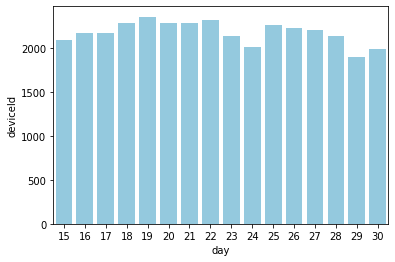

count 16.000000
mean 2172.250000
std 128.509144
min 1897.000000
25% 2117.750000
50% 2185.500000
75% 2279.250000
max 2352.000000
Name: deviceId, dtype: float64

In [ ]:
distribution_day_device_id=df_just_rabat.loc[df_just_rabat.deviceId.isin(list_deviceId)].groupby(['day','deviceId'])['latitude'].count()
distribution_day_device_id=distribution_day_device_id.reset_index()
distribution_day_device_id=distribution_day_device_id.groupby('day')['deviceId'].count()
sns.barplot(x="day", y="deviceId", data=distribution_day_device_id.reset_index(),color ='skyblue')
distribution_day_device_id.describe()

Out[53]:

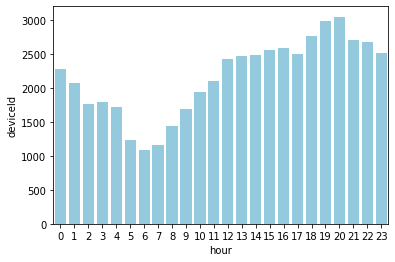

count 24.000000
mean 2168.416667
std 574.474498
min 1090.000000
25% 1750.500000
50% 2353.000000
75% 2565.500000
max 3052.000000
Name: deviceId, dtype: float64

In [ ]:
distribution_hour_device_id=df_just_rabat.loc[df_just_rabat.deviceId.isin(list_deviceId)].groupby(['hour','deviceId'])['latitude'].count()
distribution_hour_device_id=distribution_hour_device_id.reset_index()
distribution_hour_device_id=distribution_hour_device_id.groupby('hour')['deviceId'].count()
sns.barplot(x="hour", y="deviceId", data=distribution_hour_device_id.reset_index().sort_values(by=['hour']),color ='skyblue')
distribution_hour_device_id.describe()


In [ ]:
df_sorted=df_just_rabat.loc[df_just_rabat.deviceId.isin(list_deviceId)].sort_values(by=['deviceId', 'datetime'])
import pandas as pd
import numpy as np
df_sorted['datetime']= pd.to_datetime(df_sorted['datetime'])

### shift to extract period from two records
df_sorted['deviceId2']=df_sorted.deviceId.shift(periods=-1)  
df_sorted['datetime2']=df_sorted.datetime.shift(periods=-1)  

### permet de faire la difference juste entre les meme device_id
df_sorted=df_sorted.loc[df_sorted['deviceId']==df_sorted['deviceId2']] #normalement avec cette commande on perd autant de ligne qu'il y'a de device_id uniques
df_sorted['delta_time']=df_sorted['datetime2']-df_sorted['datetime']

#permet de mettre la periode en heure 
df_sorted['delta_time_hour']=df_sorted['delta_time'] / np.timedelta64(1, 'h')

df_freq_recordby_deviceid = df_sorted.loc[df_sorted['delta_time_hour'].notnull()].groupby('deviceId').delta_time_hour.mean(numeric_only=False).reset_index().rename(columns={'delta_time_hour': 'mean_freq'})

df_freq_recordby_deviceid['min_freq']=df_sorted.loc[df_sorted['delta_time_hour'].notnull()].groupby('deviceId').delta_time_hour.min(numeric_only=False).reset_index().rename(columns={'delta_time_hour': 'min_freq'})['min_freq']

df_freq_recordby_deviceid['max_freq']=df_sorted.loc[df_sorted['delta_time_hour'].notnull()].groupby('deviceId').delta_time_hour.max(numeric_only=False).reset_index().rename(columns={'delta_time_hour': 'max_freq'})['max_freq']

df_freq_recordby_deviceid['median_freq']=df_sorted.loc[df_sorted['delta_time_hour'].notnull()].groupby('deviceId').delta_time_hour.median(numeric_only=False).reset_index().rename(columns={'delta_time_hour': 'median_freq'})['median_freq']

# df_sorted.loc[df_sorted['delta_time'].notnull()]
# df_freq_recordby_deviceid.describe()
# df_sorted.info()
df_freq_recordby_deviceid
df_freq_recordby_deviceid.describe()


Out[33]:

,mean_freq,min_freq,max_freq,median_freq
count,11025.000000,11025.000000,11025.000000,11025.000000
mean,2.506145,0.010635,31.725564,0.203512
std,5.944778,0.099286,56.040450,1.325998
min,0.000000,0.000000,0.000000,0.000000
25%,0.006488,0.000000,0.028889,0.000000
50%,0.154167,0.000000,2.166389,0.000000
75%,1.974710,0.000000,42.428611,0.000000
max,73.589583,2.646667,374.958056,32.132500


In [ ]:
sudo apt install 

In [ ]:
start = time.time()
data=df_just_rabat
# Open the shapefile
regions = gpd.GeoDataFrame.from_file('/dbfs/mnt/raw/geojson_MA.json')
regions
data['latitude']=data['latitude'].astype(float)
data['longitude']=data['longitude'].astype(float)
data['coords'] = list(zip(data['longitude'],data['latitude']))
data['coords'] = data['coords'].apply(Point)
datageo = gpd.GeoDataFrame(data, geometry='coords', crs=regions.crs)

# Perform spatial join to match points and polygons
datageo = gpd.tools.sjoin(datageo, regions, predicate="within", how='left')
datageo.drop(columns={'coords','index_right','cartodb_id'},inplace=True)
end = time.time()

--------------------------------------------------------------------------- 
 ImportError Traceback (most recent call last)
 <command-993883363546927> in <module> 
 11 
 12 # Perform spatial join to match points and polygons 
 ---> 13 datageo = gpd . tools . sjoin ( datageo , regions , predicate = "within" , how = 'left' ) 
 14 datageo . drop ( columns = { 'coords' , 'index_right' , 'cartodb_id' } , inplace = True ) 
 15 end = time . time ( ) 

 /databricks/python/lib/python3.8/site-packages/geopandas/tools/sjoin.py in sjoin (left_df, right_df, how, predicate, lsuffix, rsuffix, **kwargs) 
 122 _basic_checks ( left_df , right_df , how , lsuffix , rsuffix ) 
 123 
 --> 124 indices = _geom_predicate_query ( left_df , right_df , predicate ) 
 125 
 126 joined = _frame_join ( indices , left_df , right_df , how , lsuffix , rsuffix ) 

 /databricks/python/lib/python3.8/site-packages/geopandas/tools/sjoin.py in _geom_predicate_query (left_df, right_df, predicate) 
 209 # see discussion at https://github.com/geopandas/geopandas/pull/1421 
 210 predicate = "contains" 
 --> 211 sindex = left_df . sindex
 212 input_geoms = right_df . geometry
 213 else : 

 /databricks/python/lib/python3.8/site-packages/geopandas/base.py in sindex (self) 
 2704 [2]])
 2705 """
 -> 2706 return self . geometry . values . sindex
 2707 
 2708 @ property

 /databricks/python/lib/python3.8/site-packages/geopandas/array.py in sindex (self) 
 289 def sindex ( self ) : 
 290 if self . _sindex is None : 
 --> 291 self . _sindex = _get_sindex_class ( ) ( self . data ) 
 292 return self . _sindex
 293 

 /databricks/python/lib/python3.8/site-packages/geopandas/sindex.py in _get_sindex_class () 
 19 if compat . HAS_RTREE : 
 20 return RTreeIndex
 ---> 21 raise ImportError(
 22 "Spatial indexes require either `rtree` or `pygeos`. " 
 23 "See installation instructions at https://geopandas.org/install.html" 

 ImportError : Spatial indexes require either `rtree` or `pygeos`. See installation instructions at https://geopandas.org/install.html